In [7]:
import ast
import urllib
from io import BytesIO

import numpy as np
import requests
import tensorflow as tf
import tritonclient.grpc as grpc_client
from PIL import Image


#### Create helper function, specify model name and download image

In [10]:
MODEL_NAME = "resnet50"  # Set the model name

In [11]:
def get_input_output_names_shapes(
    client: grpc_client.InferenceServerClient, model_name: str
):
    model_metadata = client.get_model_metadata(model_name)
    input_names = [input_tensor.name for input_tensor in model_metadata.inputs]
    output_names = [output_tensor.name for output_tensor in model_metadata.outputs]

    model_config = client.get_model_config(model_name)
    input_shapes = [input_tensor.dims for input_tensor in model_config.config.input]

    return input_names, output_names, input_shapes


In [12]:
# Get imagenet class names as dictionary
r = urllib.request.urlopen(
    "https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt"
).read()
class2name = ast.literal_eval(r.decode())
class2name

{0: 'tench, Tinca tinca',
 1: 'goldfish, Carassius auratus',
 2: 'great white shark, white shark, man-eater, man-eating shark, Carcharodon carcharias',
 3: 'tiger shark, Galeocerdo cuvieri',
 4: 'hammerhead, hammerhead shark',
 5: 'electric ray, crampfish, numbfish, torpedo',
 6: 'stingray',
 7: 'cock',
 8: 'hen',
 9: 'ostrich, Struthio camelus',
 10: 'brambling, Fringilla montifringilla',
 11: 'goldfinch, Carduelis carduelis',
 12: 'house finch, linnet, Carpodacus mexicanus',
 13: 'junco, snowbird',
 14: 'indigo bunting, indigo finch, indigo bird, Passerina cyanea',
 15: 'robin, American robin, Turdus migratorius',
 16: 'bulbul',
 17: 'jay',
 18: 'magpie',
 19: 'chickadee',
 20: 'water ouzel, dipper',
 21: 'kite',
 22: 'bald eagle, American eagle, Haliaeetus leucocephalus',
 23: 'vulture',
 24: 'great grey owl, great gray owl, Strix nebulosa',
 25: 'European fire salamander, Salamandra salamandra',
 26: 'common newt, Triturus vulgaris',
 27: 'eft',
 28: 'spotted salamander, Ambystoma 

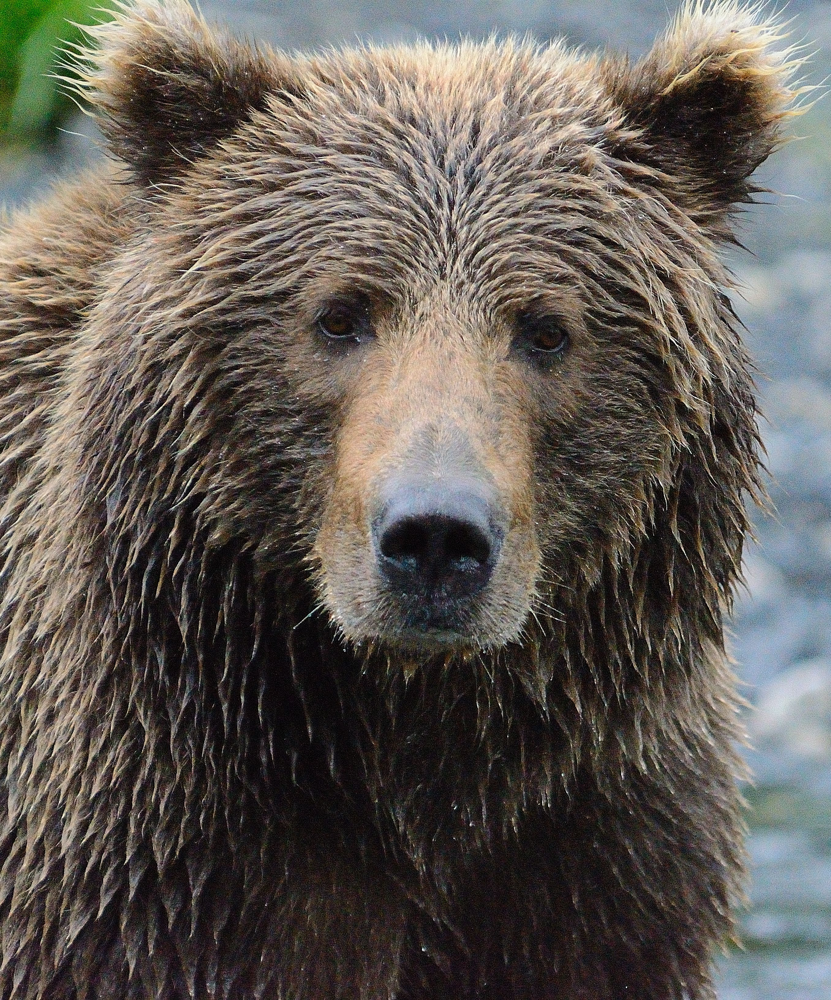

In [13]:

# Url to retrieve an image from the internet
url = "https://i1.wp.com/robinbarefield.com/wp-content/uploads/2015/03/DSC_1763.jpg"
response = requests.get(url)
img = Image.open(BytesIO(response.content))  # read the image with PIL
img

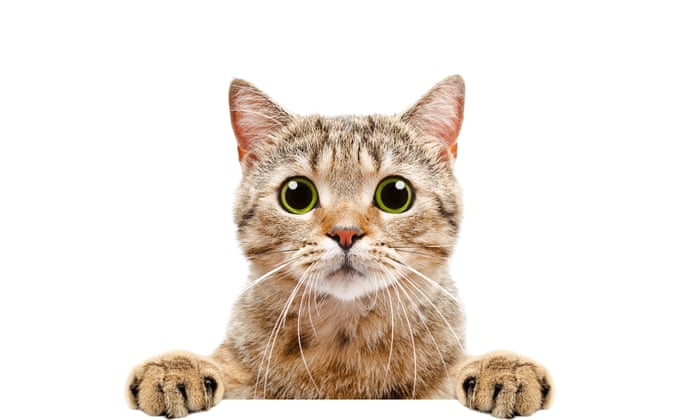

In [57]:


# Url to retrieve an image from the internet
url = "https://i.guim.co.uk/img/media/26392d05302e02f7bf4eb143bb84c8097d09144b/446_167_3683_2210/master/3683.jpg?width=700&quality=85&auto=format&fit=max&s=fa2a6e634973defc13bfcbae1b8e954d"
response = requests.get(url)
img = Image.open(BytesIO(response.content))  # read the image with PIL
img

## Prepare for inference

#### Connect to client after starting inference server docker container

```bash 
docker run --rm -p8000:8000 -p8001:8001 -p8002:8002 -v/path/to/model_repository:/models nvcr.io/nvidia/tritonserver:23.08-py3 tritonserver --model-repository=/models

In [14]:
#connect to the server
client = grpc_client.InferenceServerClient('localhost:8001')
client


#### Get the names and shapes of the input and output tensors

In [17]:
input_names, output_names, input_shapes = get_input_output_names_shapes(
    client, MODEL_NAME
)

input_names, output_names, input_shapes

(['input_1'], ['predictions'], [[224, 224, 3]])

#### Preprocess image

In [59]:
# Resize the image to expected input shape of the model
width, height = input_shapes[0][0], input_shapes[0][1]
img = img.resize((width, height))

# Convert the downloaded image to RGB
input_data = np.array(img.convert("RGB")).astype(np.float32)

# Preprocess the image for the ResNet50 model
input_data = tf.keras.applications.resnet50.preprocess_input(input_data)

# Add the dimension for the batch size
input_data = np.expand_dims(input_data, 0)

input_data.shape

(1, 224, 224, 3)

#### Create input inference objects (tensors) and invoke inference with expected output tensor name

In [60]:
# Create and fill the actual input tensor to the model
input_tensor = grpc_client.InferInput(input_names[0], input_data.shape, "FP32")
input_tensor.set_data_from_numpy(input_data)

# Run inference
inputs = [input_tensor]
outputs = [
    grpc_client.InferRequestedOutput(output_name)
    for output_name in output_names
]
result = client.infer(model_name=MODEL_NAME, inputs=inputs, outputs=outputs)


#### Check results

In [61]:
result

In [62]:

output_names

['predictions']

In [63]:
result.as_numpy(output_names[0])

array([[5.88358716e-07, 2.31802460e-06, 1.35498851e-06, 8.68934251e-07,
        1.71765373e-06, 2.18556870e-05, 2.95908563e-07, 3.21741459e-06,
        7.89295336e-06, 3.92729680e-06, 1.69937994e-05, 3.06791844e-06,
        6.95981944e-05, 7.50231038e-06, 1.16564945e-06, 1.60056850e-04,
        1.17172085e-05, 4.54026394e-06, 2.80313066e-06, 8.91969194e-07,
        9.45218835e-06, 5.88800503e-05, 1.90482770e-05, 2.81424127e-06,
        1.97247457e-04, 4.45711407e-07, 1.45790546e-06, 1.04011224e-06,
        1.04436526e-06, 4.17507692e-07, 8.48833406e-06, 3.82130611e-06,
        2.22018411e-06, 2.68885174e-07, 6.18708157e-07, 4.32786322e-07,
        1.95935422e-06, 1.35824484e-06, 2.75412331e-05, 2.86593468e-06,
        1.14873831e-06, 1.95034336e-05, 4.27996201e-06, 9.42299084e-06,
        8.24430572e-06, 4.55152048e-07, 3.76812341e-06, 2.08002075e-06,
        2.80680467e-07, 6.29185365e-07, 7.81655046e-07, 3.05402173e-05,
        1.84243254e-06, 1.04802689e-06, 3.30691978e-06, 1.981584

In [64]:
result.as_numpy(output_names[0]).shape

(1, 1000)

In [65]:
# Print out predicted class name
print(class2name[np.argmax(result.as_numpy(output_names[0]))])

Egyptian cat
